In [2]:
import numpy as np
import itertools
import networkx as nx
from networkx.algorithms import community
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
def adj_mat_to_graph(A,percentile):
    edge_weights = map(lambda i: abs(i[2]['weight']), nx.from_numpy_matrix(A).edges.data())
    thresh = np.percentile(edge_weights,percentile)
    A_thresh = np.copy(A)
    A_thresh[abs(A_thresh) < thresh] = 0
    return nx.from_numpy_matrix(A_thresh)
    
def draw_graph(G):
    fig, ax = plt.subplots(figsize=(25, 25))
    nx.draw(G, ax=ax, node_color="red", node_size=50, alpha=0.25)
    #nx.draw_spectral(G, ax=ax, node_color="red", node_size=50, alpha=0.25) #ugly
    fig.show()

def plot_hist(X,bs):
    plt.hist(X, bins=bs)
    plt.show()
    
def get_edge_weights(G):
    return map(lambda j: j[2]['weight'], G.edges.data())

In [4]:
adj_mat_dir = "./adjacency_matrices/"
adj_mat_files = ['Behavioral Prediction Similarity_Bilateral Perturbation_BAYLORGC4_2018_03_20.mat.npy',
                 'Behavioral Prediction Similarity_No Perturbation_BAYLORGC4_2018_03_20.mat.npy',
                 'Causality_Bilateral Perturbation_BAYLORGC4_2018_03_20.mat.npy',
                 'Causality_No Perturbation_BAYLORGC4_2018_03_20.mat.npy',
                 'Correlation_Bilateral Perturbation_BAYLORGC4_2018_03_20.mat.npy',
                 'Correlation_No Perturbation_BAYLORGC4_2018_03_20.mat.npy']
adj_mats = []
full_graphs = []
for i in adj_mat_files:
    A = np.load(adj_mat_dir+i)
    adj_mats += [A]

(84, 3486)


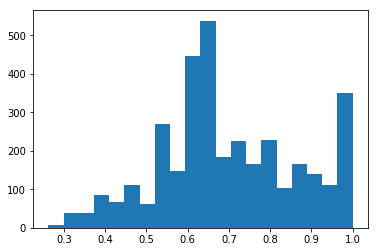

(84, 3486)


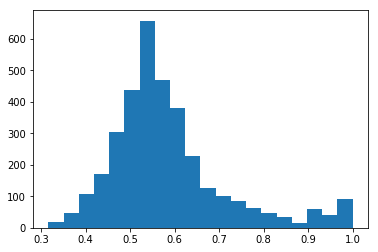

(84, 3486)


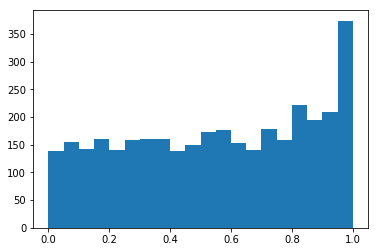

(84, 3486)


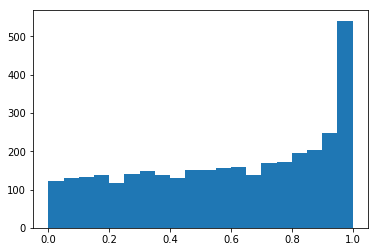

(84, 3486)


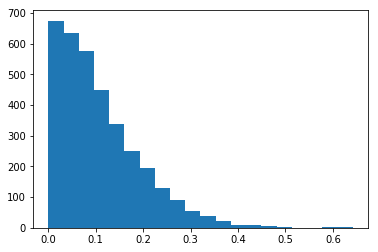

(84, 3486)


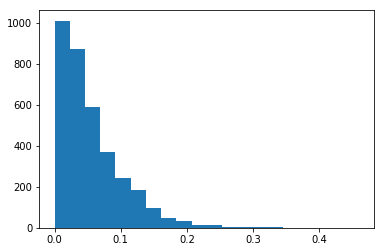

/Users/jack/miniconda2/lib/python2.7/site-packages/matplotlib/figure.py:418: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


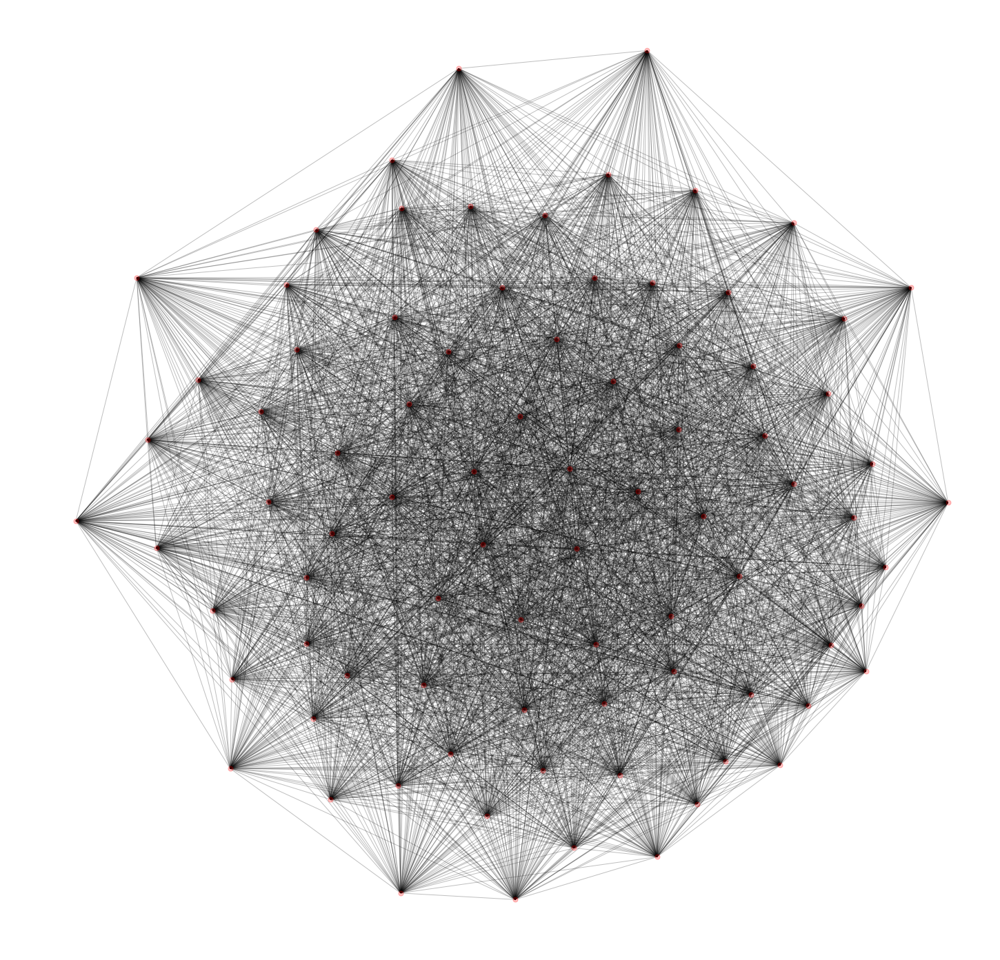

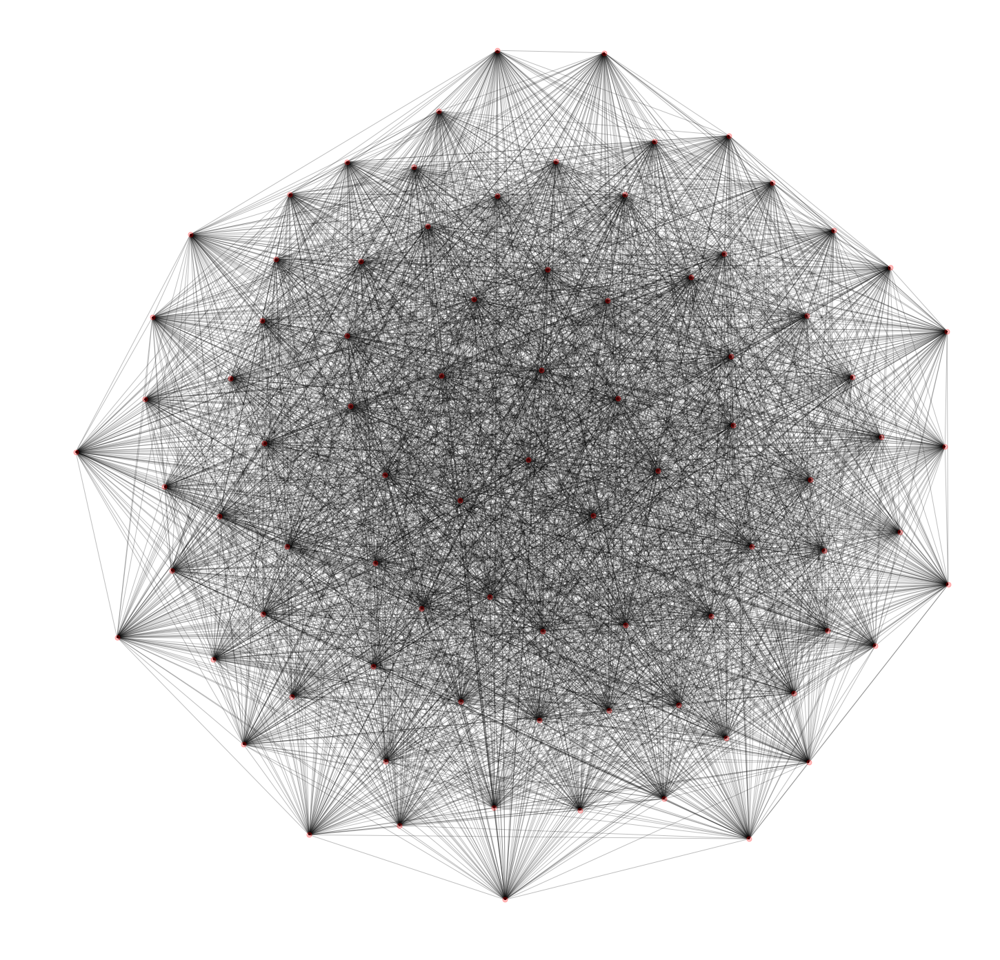

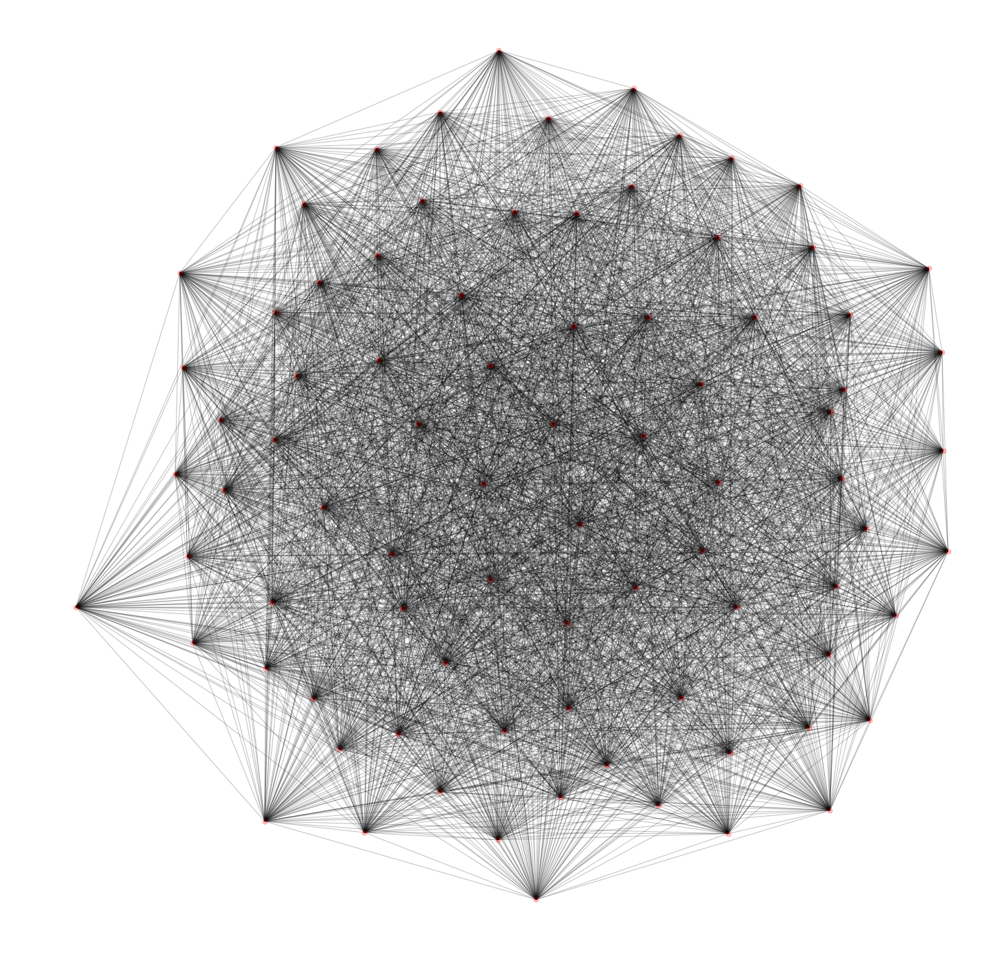

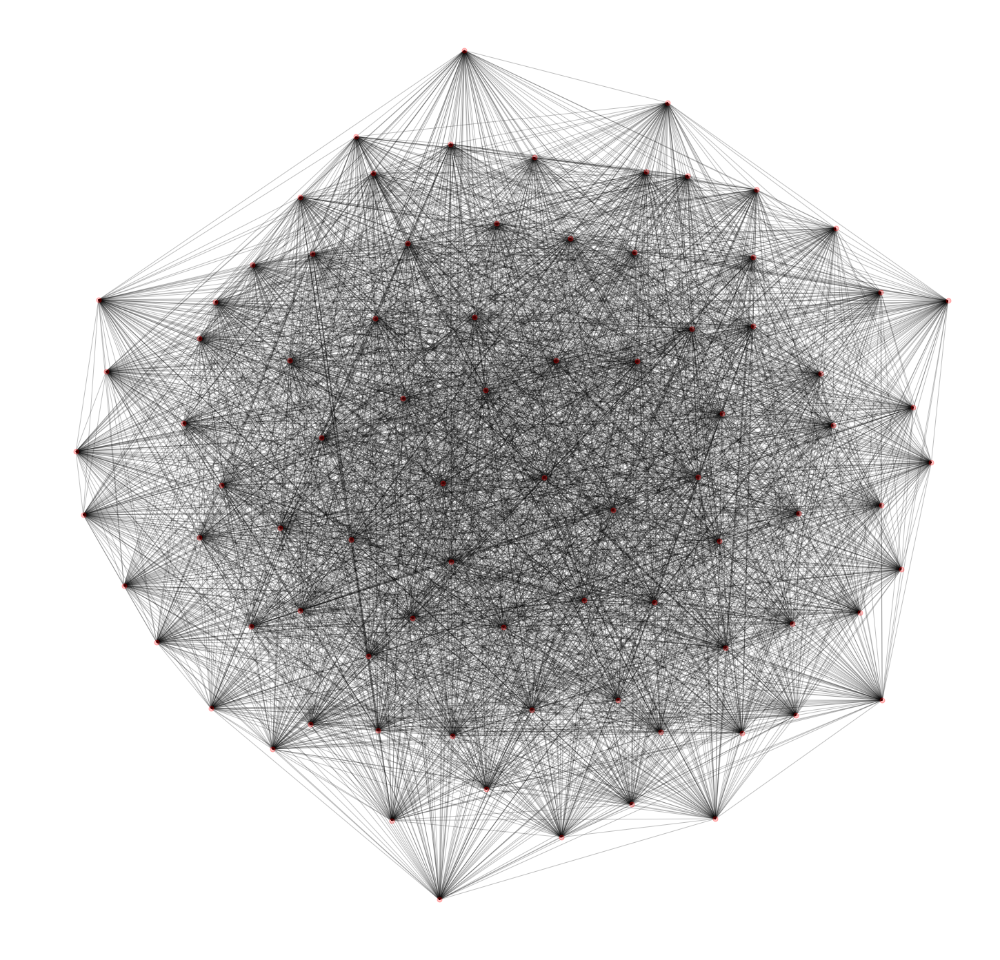

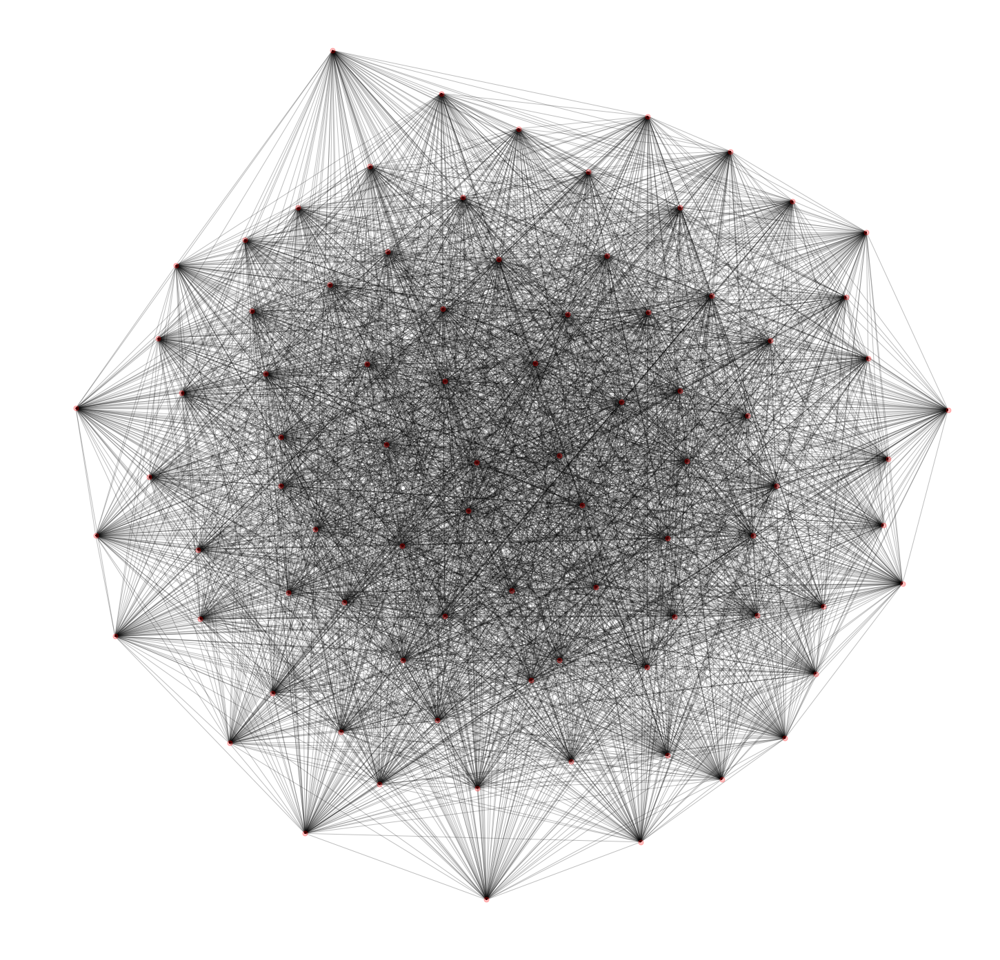

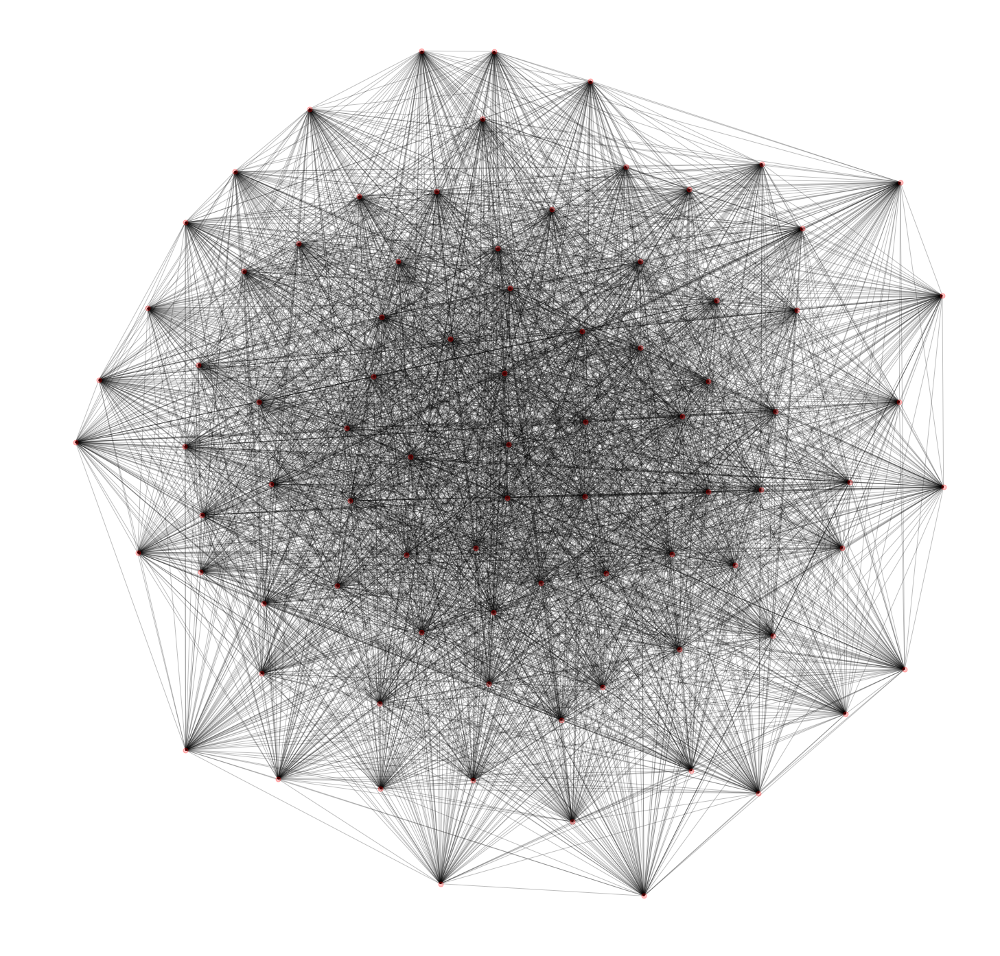

In [5]:
for i in adj_mats:
    G = adj_mat_to_graph(i,0)
    print(len(G.nodes()), len(G.edges()))
    plot_hist(get_edge_weights(G),20)
    
for i in adj_mats:
    G = adj_mat_to_graph(i,0)
    draw_graph(G)

84 766


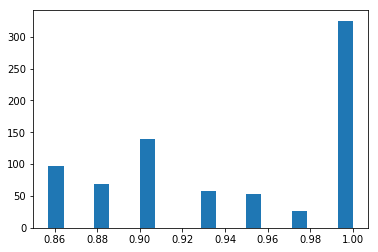

84 711


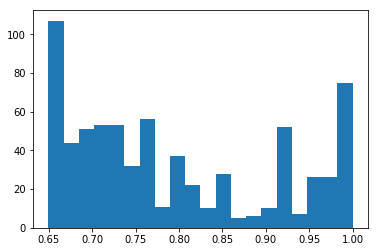

84 1248


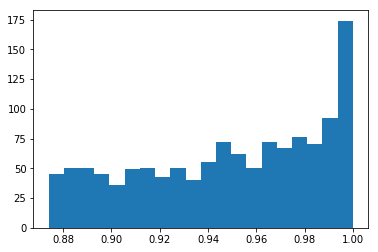

84 1193


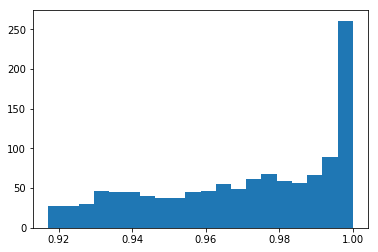

84 698


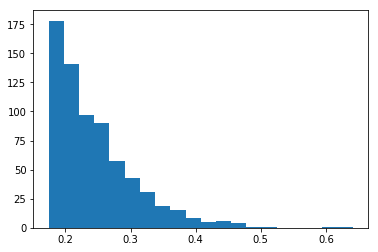

84 698


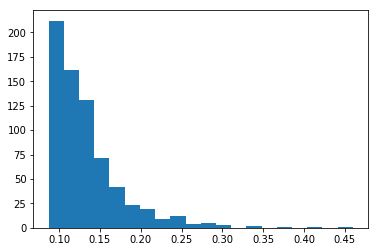

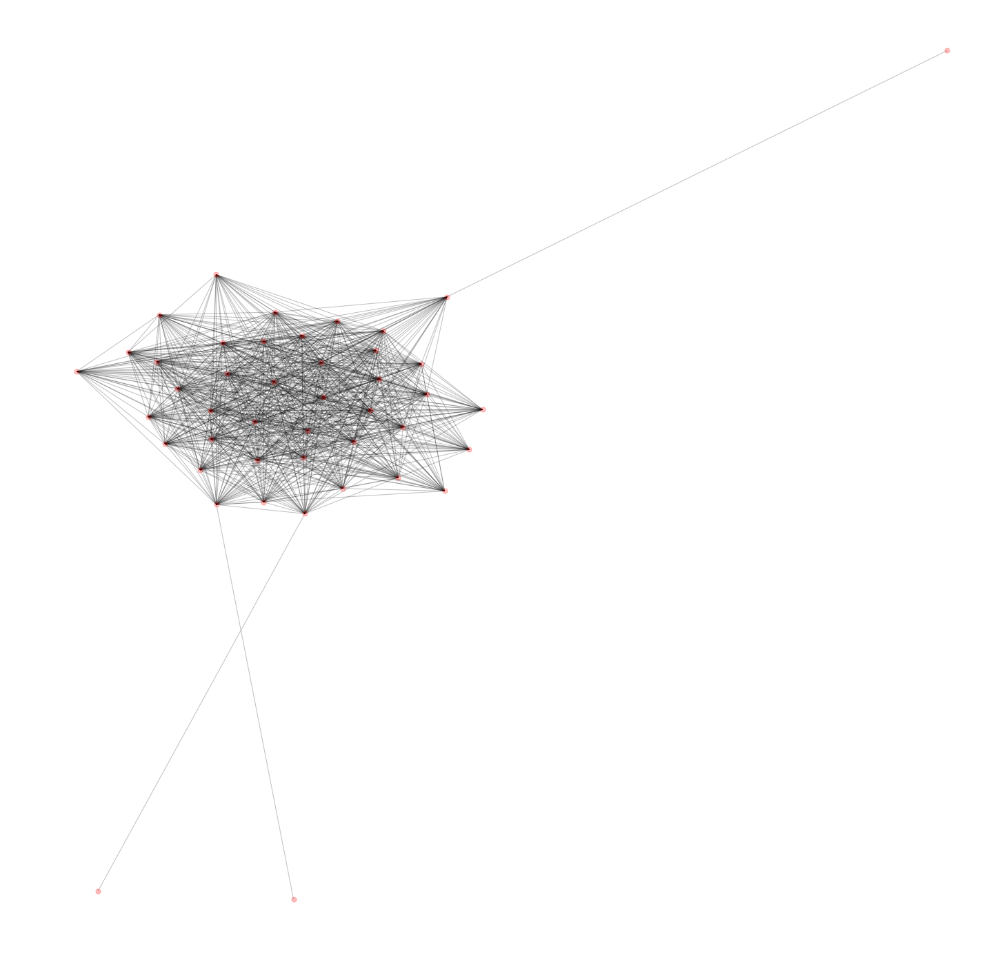

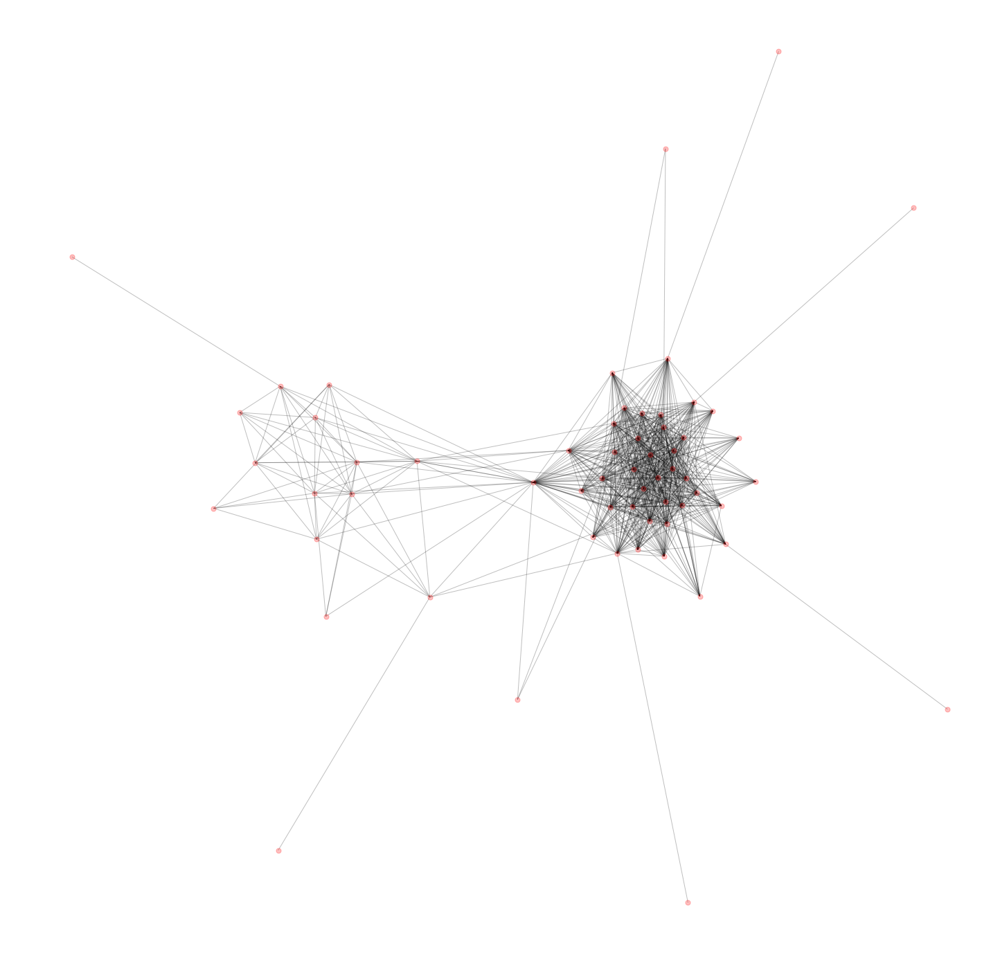

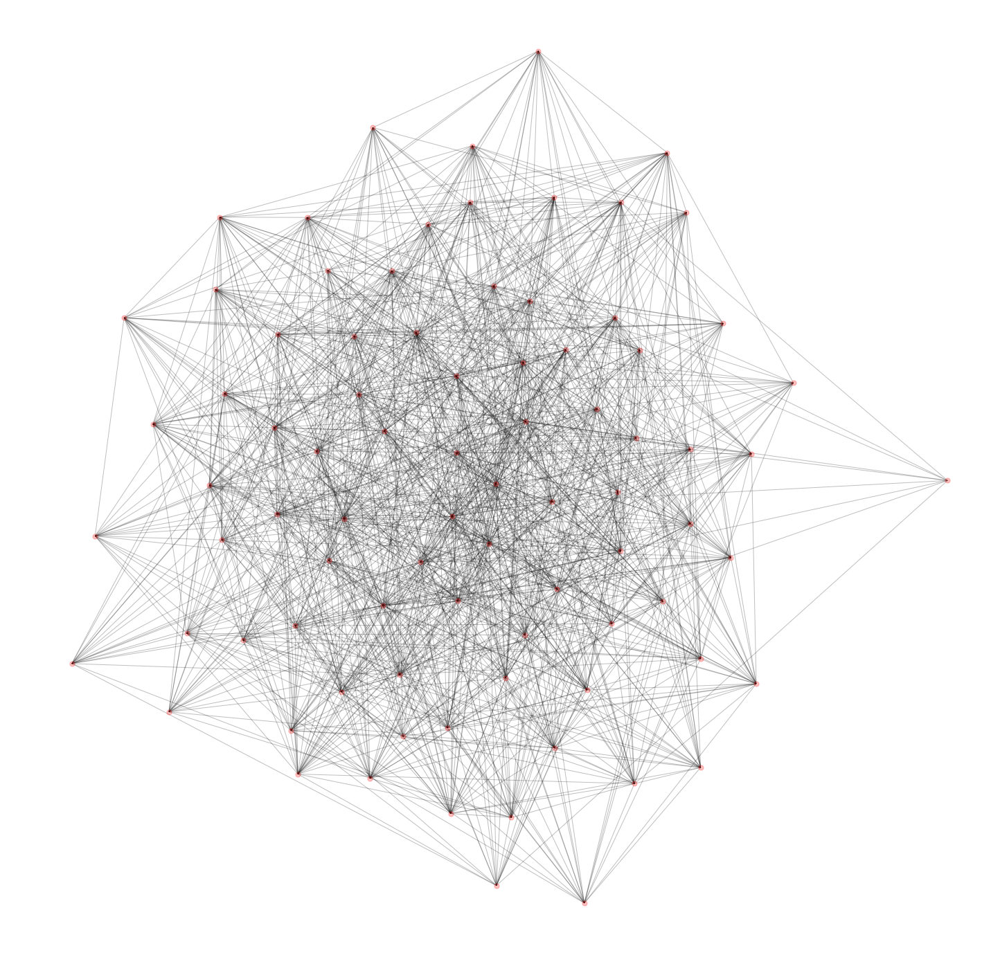

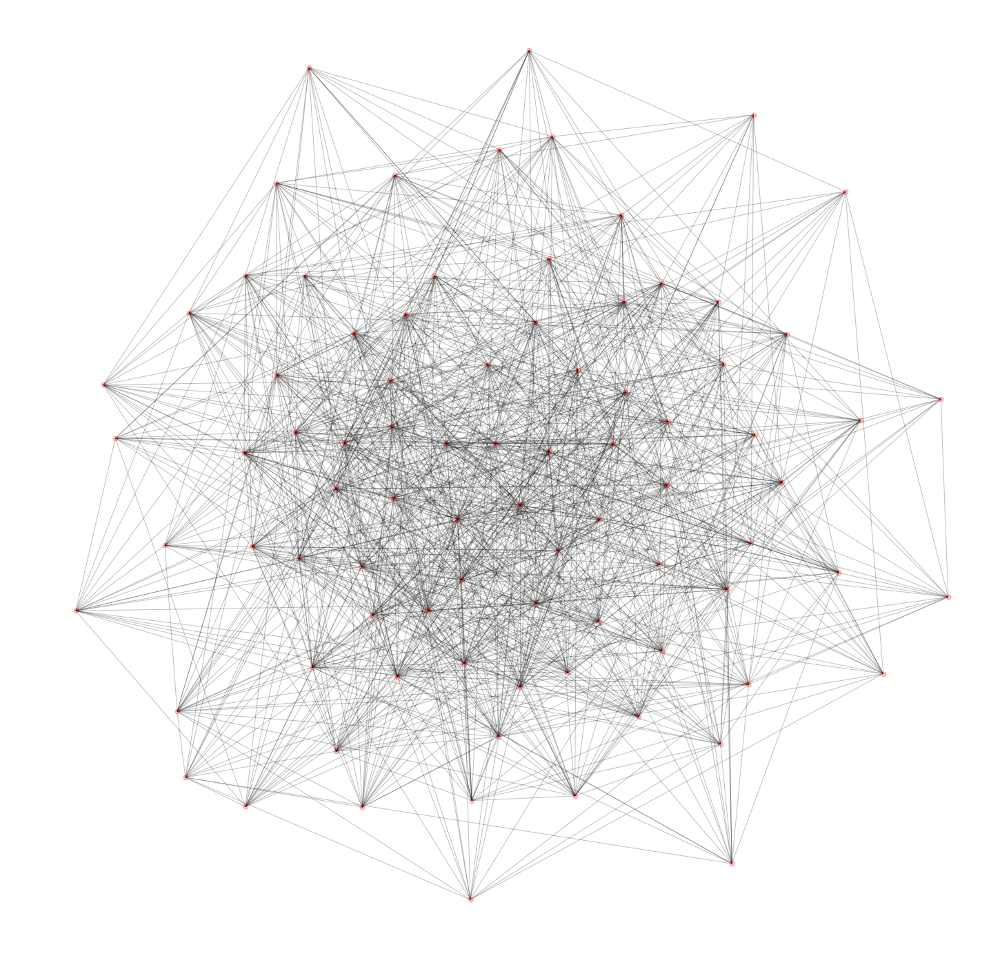

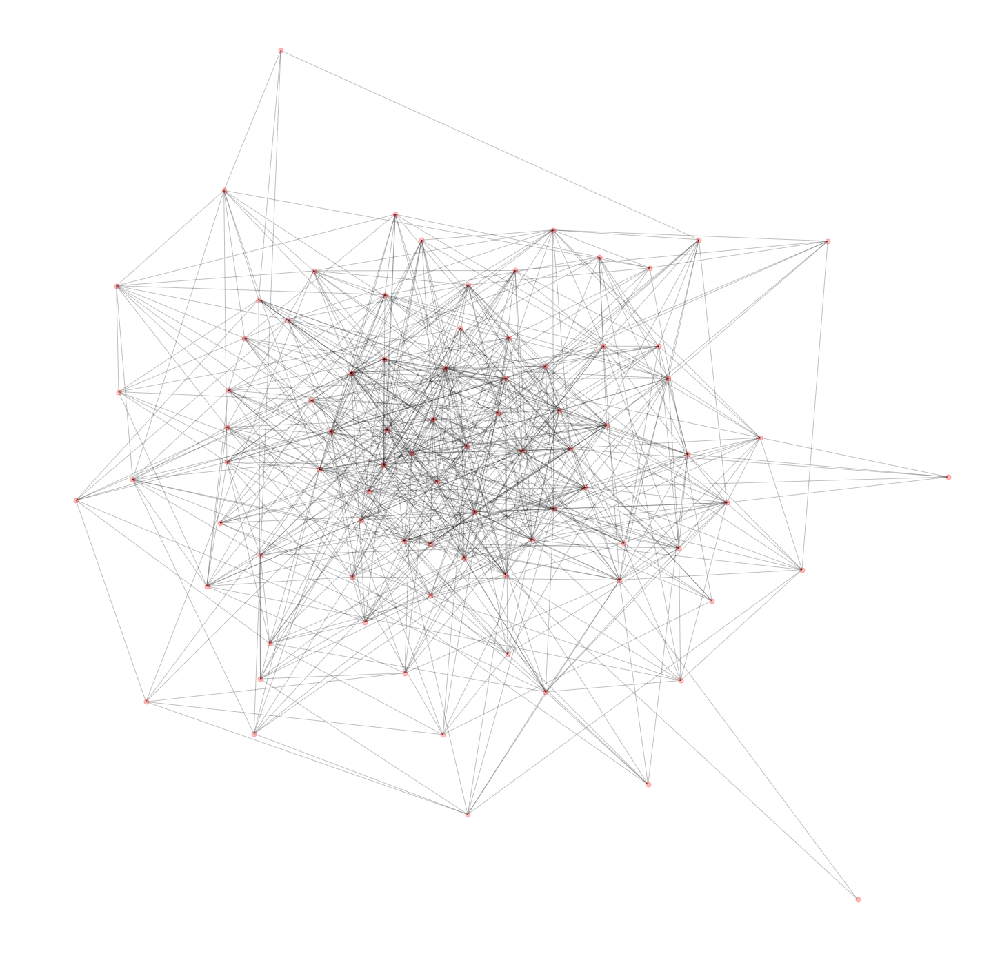

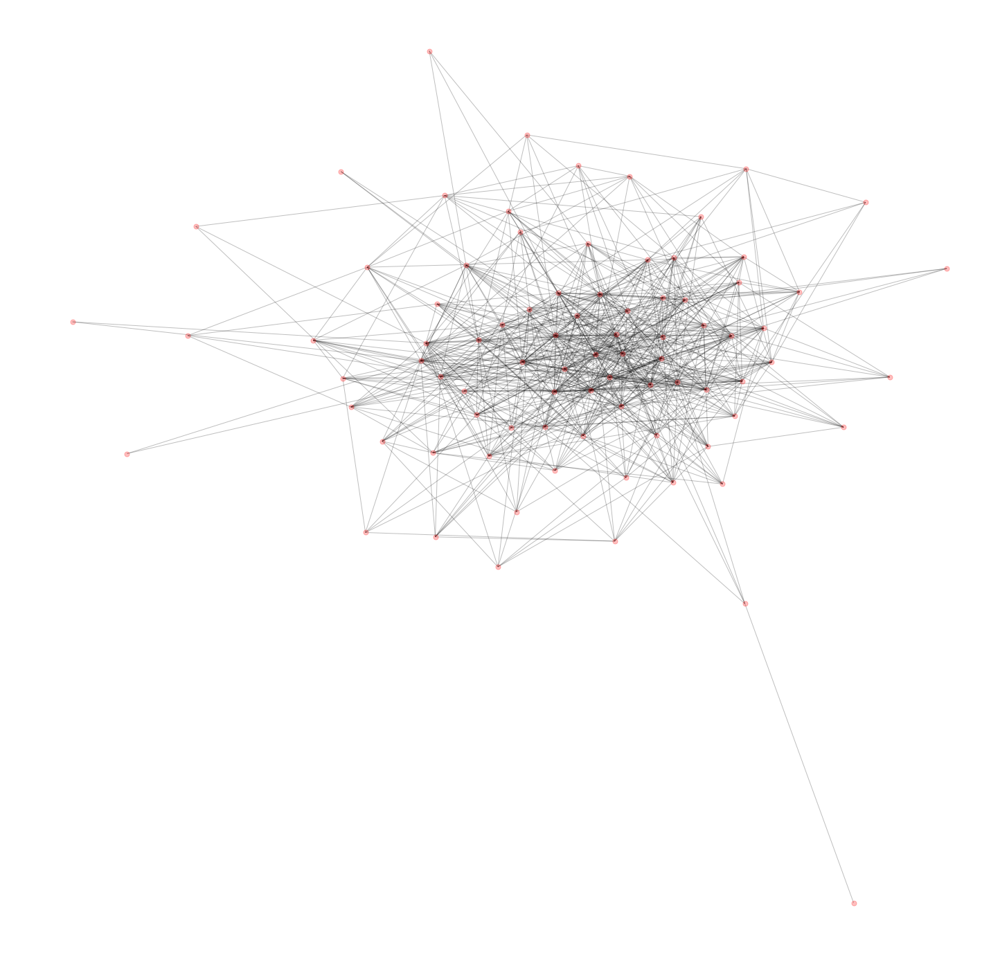

In [6]:
for i in adj_mats:
    G = adj_mat_to_graph(i,80)
    print len(G.nodes()), len(G.edges())
    plot_hist(get_edge_weights(G),20)
    
for i in adj_mats:
    G = adj_mat_to_graph(i,80)
    isol = nx.isolates(G)
    isol = list(isol)
    G.remove_nodes_from(isol)
    draw_graph(G)

In [7]:
def find_clusters(G,percentile):
    KLB_subgraphs = [] #considers weights but not direction
    CNM_subgraphs = [] #considers neither weights nor direction
    AS_subgraphs = [] #considers weights but not direction
    LP_subgraphs = [] #considers neither weights nor direction 
    #GN_subgraphs = [] #considers neither weights nor direction
    
    for i in adj_mats:
        G = adj_mat_to_graph(i,percentile)

        sgs = community.kernighan_lin_bisection(G, max_iter=10)
        KLB_subgraphs += [[list(sgs[0]), list(sgs[1])]]

        CNM_subgraphs += [map(list, community.greedy_modularity_communities(G))]
        
        AS_subgraphs += [map(list, list(community.asyn_lpa_communities(G)))]
        
        LP_subgraphs += [map(list, list(community.label_propagation_communities(G)))]
        
        #print community.girvan_newman(G, most_valuable_edge=None)
        
        #comp = community.girvan_newman(G, most_valuable_edge=None)
        #for communities in itertools.islice(comp, 3):
        #    print(tuple(sorted(c) for c in communities))
            
    return KLB_subgraphs, CNM_subgraphs, AS_subgraphs, LP_subgraphs#, GN_subgraphs

clusters = []
for i in [10,20,30,40,55,65,80,90]:
    print i
    clusters += [find_clusters(G,i)]

10
20
30
40
55
65
80
90


In [8]:
clust_num_thresh = 4
num_clusts = np.array(map(lambda i: map(lambda j: map(lambda k: sum(map(lambda l: len(l)>=clust_num_thresh, k)), j), i), clusters))
print(num_clusts)

[[[ 2  2  2  2  2  2]
  [ 1  1  0  0  0  0]
  [ 1  1  1  1  1  1]
  [ 1  1  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 4  1  0  0  0  0]
  [ 1  1  1  1  1  1]
  [ 1  1  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 6  1  0  0  0  0]
  [ 1  1  1  1  1  1]
  [ 1  1  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 7  2  5  6  0  0]
  [ 1  1  1  1  1  1]
  [ 1  1  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 6  6  7  6  0  0]
  [ 1  1  1  1  1  1]
  [ 1  1  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 8  7  5  5  0  0]
  [ 1  1  1  1  1  1]
  [ 1  1  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 6  7  4  4  8  0]
  [ 1  2  1  1  1  1]
  [ 1  2  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 1  5  4  5 12  3]
  [ 1  2  1  1  1  1]
  [ 1  2  1  1  1  1]]]


In [9]:
G1 = adj_mat_to_graph(adj_mats[2], 80)
G2 = adj_mat_to_graph(adj_mats[3], 80)

CNM_subgraphs1 = map(list, community.greedy_modularity_communities(G1))
CNM_subgraphs2 = map(list, community.greedy_modularity_communities(G2))
print len(CNM_subgraphs1), len(CNM_subgraphs2)

clust_num_thresh = 4
large_CNM_subgraphs1 = []
for i in CNM_subgraphs1:
    if len(i) >= clust_num_thresh:
        large_CNM_subgraphs1 += [i]
large_CNM_subgraphs2 = []
for i in CNM_subgraphs2:
    if len(i) >= clust_num_thresh:
        large_CNM_subgraphs2 += [i]
print len(large_CNM_subgraphs1), len(large_CNM_subgraphs2)

print large_CNM_subgraphs1
print large_CNM_subgraphs2

6 4
4 4
[[7, 8, 15, 17, 20, 26, 28, 29, 30, 31, 37, 38, 39, 46, 47, 48, 49, 57, 58, 64, 68, 71, 72, 73, 75, 78, 81], [0, 33, 67, 4, 5, 6, 63, 74, 43, 44, 61, 79, 82, 83, 53, 54, 25, 59, 42, 62, 69], [32, 65, 2, 35, 36, 1, 41, 10, 11, 12, 66, 77, 16, 50, 18, 51, 23, 24, 55, 60], [34, 3, 40, 9, 76, 13, 14, 45, 52, 56, 27]]
[[0, 2, 4, 7, 13, 14, 16, 18, 21, 22, 30, 31, 33, 43, 49, 50, 55, 57, 61, 62, 63, 66, 68, 71, 72, 73, 77, 78], [19, 67, 6, 39, 8, 9, 75, 12, 45, 46, 15, 40, 60, 3, 20, 53, 41, 52, 59, 28, 44], [64, 65, 34, 35, 36, 5, 70, 32, 10, 47, 74, 79, 80, 81, 82, 83, 56, 24, 58, 27, 29], [1, 37, 38, 42, 11, 76, 48, 17, 51, 54, 23, 25, 26, 69]]


In [10]:
def calc_overlap(s1, s2):
    return len(np.intersect1d(s1,s2))*1.0/len(np.union1d(s1,s2))

for i in large_CNM_subgraphs1:
    print len(i)
    
for i in large_CNM_subgraphs2:
    print len(i)

sm = np.zeros((4,4))
for i in range(4):
    for j in range(4):
        sm[i][j] = calc_overlap(large_CNM_subgraphs1[i], large_CNM_subgraphs2[j])
print sm
#i,j = 0,0
#i,j = 3,1
#i,j = 2,2
#i,j = 1,3

for i in large_CNM_subgraphs1:
    print sum(map(lambda j: j >= 39, i))*1.0/len(i)
    
for i in large_CNM_subgraphs2:
    print sum(map(lambda j: j >= 39, i))*1.0/len(i)

27
21
20
11
28
21
21
14
[[0.22222222 0.17073171 0.11627907 0.13888889]
 [0.16666667 0.13513514 0.13513514 0.12903226]
 [0.17073171 0.07894737 0.17142857 0.13333333]
 [0.05405405 0.18518519 0.10344828 0.04166667]]
0.555555555556
0.714285714286
0.4
0.454545454545
0.535714285714
0.571428571429
0.571428571429
0.428571428571


6 4
4 4


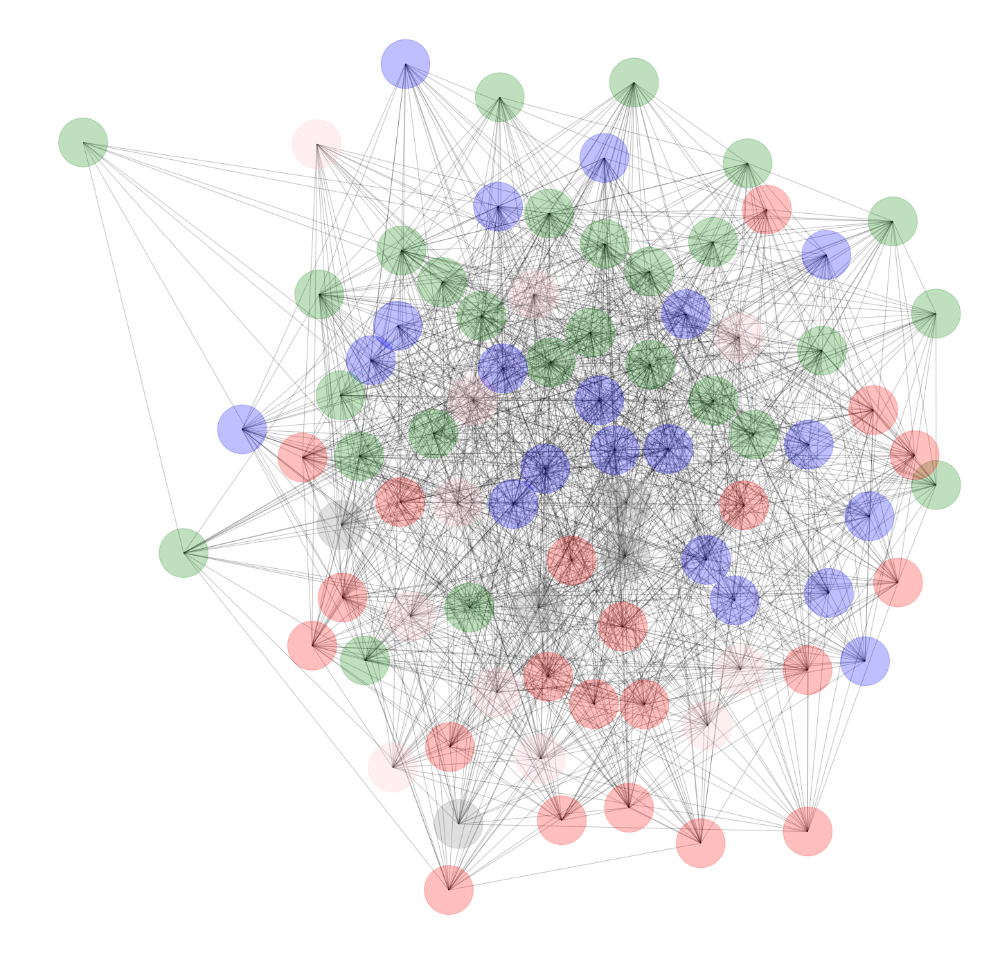

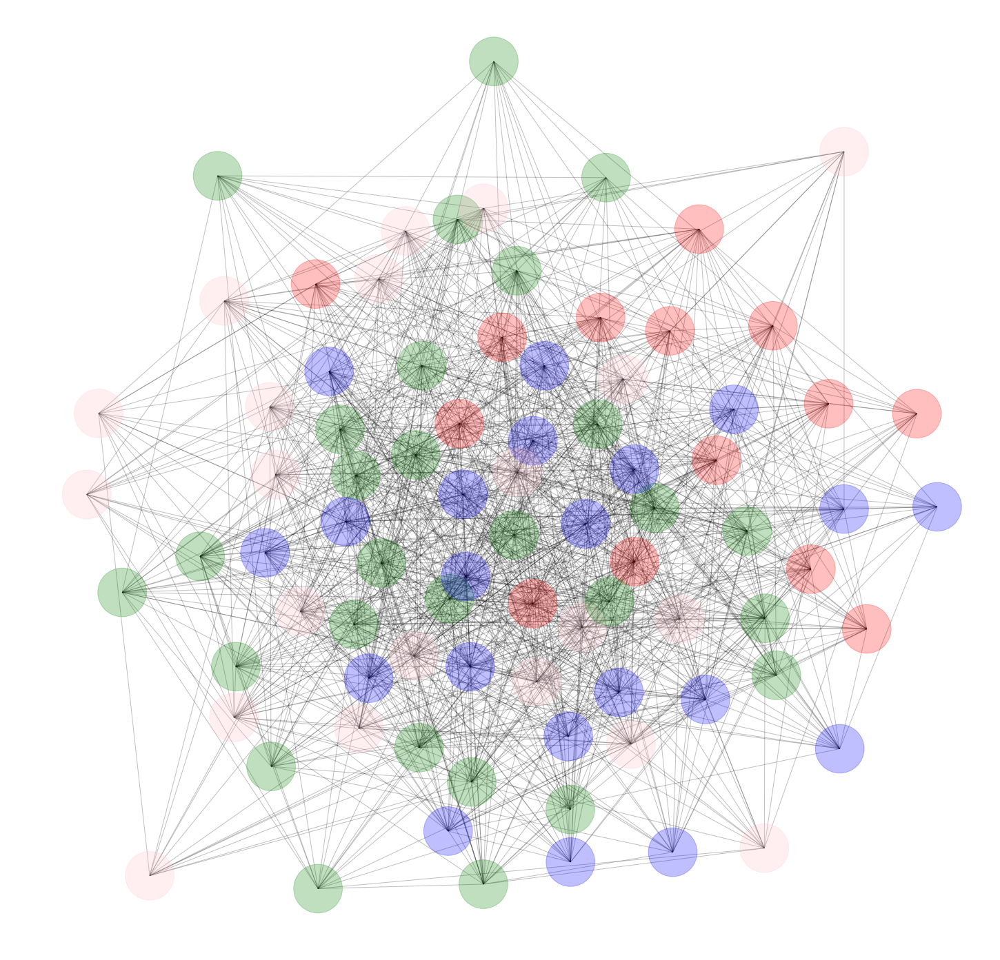

In [11]:
G1 = adj_mat_to_graph(adj_mats[2], 80)
G2 = adj_mat_to_graph(adj_mats[3], 80)

CNM_subgraphs1 = map(list, community.greedy_modularity_communities(G1))
CNM_subgraphs2 = map(list, community.greedy_modularity_communities(G2))
print len(CNM_subgraphs1), len(CNM_subgraphs2)

clust_num_thresh = 4
large_CNM_subgraphs1 = []
for i in CNM_subgraphs1:
    if len(i) >= clust_num_thresh:
        large_CNM_subgraphs1 += [i]
large_CNM_subgraphs2 = []
for i in CNM_subgraphs2:
    if len(i) >= clust_num_thresh:
        large_CNM_subgraphs2 += [i]
print len(large_CNM_subgraphs1), len(large_CNM_subgraphs2)

color_map1 = []
for node in G1:
    if node in large_CNM_subgraphs1[0]:
        color_map1 += ['green']
    elif node in large_CNM_subgraphs1[1]:
        color_map1 += ['red'] 
    elif node in large_CNM_subgraphs1[2]:
        color_map1 += ['blue'] 
    elif node in large_CNM_subgraphs1[3]:
        color_map1 += ['pink'] 
    else:
        color_map1 += ['grey'] 
fig, ax = plt.subplots(figsize=(25, 25))
nx.draw(G1, ax=ax, node_color=color_map1, node_size=5000, alpha=0.25)
fig.show()
    
    
color_map2 = []
for node in G2:
    if node in large_CNM_subgraphs2[0]:
        color_map2 += ['green']
    elif node in large_CNM_subgraphs2[1]:
        color_map2 += ['pink'] 
    elif node in large_CNM_subgraphs2[2]:
        color_map2 += ['blue'] 
    elif node in large_CNM_subgraphs2[3]:
        color_map2 += ['red'] 
    else:
        color_map2 += ['grey'] 
fig, ax = plt.subplots(figsize=(25, 25))
nx.draw(G2, ax=ax, node_color=color_map2, node_size=5000, alpha=0.25)
fig.show()